
===================================================================================================
# Test the hologram performances with HD205905 data 05 jun 2017
==================================================================================================

- author : Sylvie
- date   : October 2nd th 2017
- update : October 6th 2017


Inspired from Jeremy's work on PN and QSO

> This notebook start from images that has been deflated. So the task. is the following
> 1) Find the central star position
> 2) Find the rotation using the Hessian technique (from Jeremy)
> 3) Turn the images and cut
> 4) save for later analysis

The task of this notbook is organized in 3 sections.

- The Section 1 : deals with central star location. At the end of Section 1 sub-images containing the central star and the dispersed spectra are saved in fits file.
-> notice that important ascii file on first order position is save for later wavelength calibration   

- The section 2 : search the rotation angle of dispersed spectrum by applying an Hessian method. At the end of section 2, the rotated images are saves in fits file

- The section 3 was supposed to reconstruct spectra, but I prefer to reconstruct the spectra in another notbook. Indeed, selection critera are seet up in **Ana2DShapeSpectra** notebook.

Notice that when there is a large number of files open in input, the notebook may fail. So the section 1 and 2 may be run one after the other but in different jupyter notebook session because the intermediate files have been saved.
But some common initialisation at the top of this notebook is mandatory for each independant session 




#### problem because limitation in output of data

- firt I tried to generate a config file for jupyter

If you ran jupyter notebook --generate-config to create it, it should be in the correct place already. If not, try putting it at ~/.jupyter/jupyter_notebook_config.py

- and I set : 
> c.NotebookApp.iopub_data_rate_limit = 1000000

but it failed again so I launch jupyter as follow:

> jupyter notebook --NotebookApp.iopub_data_rate_limit=10000000 full_baseanalysis.ipynb 

So it behaves better


- however Jupyter notbook may not save the change !!!!!!!!

# Initialisation of the notebook

In [3]:
%%javascript
var kernel = IPython.notebook.kernel;
var thename = window.document.getElementById("notebook_name").innerHTML;
var command = "theNotebook = " + "'"+thename+"'";
kernel.execute(command);

<IPython.core.display.Javascript object>

In [34]:
%matplotlib inline
%load_ext autoreload
%autoreload 2

print theNotebook
from IPython.display import Image, display
import sys
sys.path.append("../../common_tools/")
from common_notebook import *

init_notebook()

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload
full_baseanalysis
ccdproc version 1.2.0
bottleneck version 1.2.1
/Users/dagoret/MacOSX/GitHub/LSST/CTIOAnaJun2017/ana_05jun17/HD205905


In [5]:
from astropy.modeling import models, fitting

In [6]:
import pandas as pd

## Input directory

- specify which are the input images

In [7]:
inputdir="/Users/dagoret/DATA/CTIODataJune2017_reducedRed/data_05jun17"
MIN_IMGNUMBER=46
MAX_IMGNUMBER=126
date="20170605"
object_name='HD205905'
tag = "reduc"
SelectTagRe='^%s_%s_([0-9]+).fits$' % (tag,date) # regular expression to select the file
SearchTagRe='^%s_%s_[0-9]+.fits$' % (tag,date)
NBIMGPERROW=2

## Output directory

- specify where are stored the cut images as well as the plot produced

In [8]:
dir_top_images="images_notebooks/"+theNotebook ### Top directory to save images
ensure_dir(dir_top_images) # create that directory

outputdir="./cut_fitsimages"
ensure_dir(outputdir)

## End of mandatory initialisation

-------------------------------------------------------
# Now  skip to the section to be re-run
-------------------------------------------------------


- Section 1: Find the central star and cut the image around the the dispersed spectrum
- Section 2 : find the dispersion axis angle of rotation wrt X-axis and apply the rotation
- Section 3 : Check with 1D spectrum

# Section 1 : Find the central star and cut the image around the the dispersed spectrum

## Read of the image spectra

In [9]:
dirlist_all = [inputdir] # only one directory to process
sorted_numbers,sorted_files = MakeFileList(dirlist_all,MIN_IMGNUMBER,MAX_IMGNUMBER,SelectTagRe,SearchTagRe) 

all_dates,all_airmass,all_images,all_titles,all_header,all_expo,all_filt=BuildImages(sorted_files,sorted_numbers,object_name)

print 'Number of images:',len(all_images)

Number of images: 80


## Sort the index according the disperser type



### tabulated disperser-filters

- in common_notebook

In [10]:
print Filt_names

['dia Ron400', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Ron200', 'Unknown']


### filter-disperser in our data

- check the filter names are inside Filt_names

In [11]:
print all_filt

['dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Thor300', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Thor300', 'dia Ho

###  Do the disperser sorting



In [12]:
filt0_idx,filt1_idx,filt2_idx,filt3_idx,filt4_idx,filt5_idx,filt6_idx=get_filt_idx(all_filt)

### Check the sorting result

In [13]:
print 'filt0_idx :: ',filt0_idx
print 'filt1_idx :: ',filt1_idx
print 'filt2_idx :: ',filt2_idx
print 'filt3_idx :: ',filt3_idx
print 'filt4_idx :: ',filt4_idx
print 'filt5_idx :: ',filt5_idx
print 'filt6_idx :: ',filt5_idx

filt0_idx ::  []
filt1_idx ::  [ 0  4  8 12 16 20 24 28 32 36 40 44 48 52 55 59 63 67 71 75 79]
filt2_idx ::  [ 1  5  9 13 17 21 25 29 33 37 41 45 49 56 60 64 68 72 76]
filt3_idx ::  [ 2  6 10 14 18 22 26 30 34 38 42 46 50 53 57 61 65 69 73 77]
filt4_idx ::  [ 3  7 11 15 19 23 27 31 35 39 43 47 51 54 58 62 66 70 74 78]
filt5_idx ::  []
filt6_idx ::  []


## Example for one raw image


- the idea is to check where is the center of the main star
- size 2k x 2 K

In [14]:
# select the index
sel_index=1

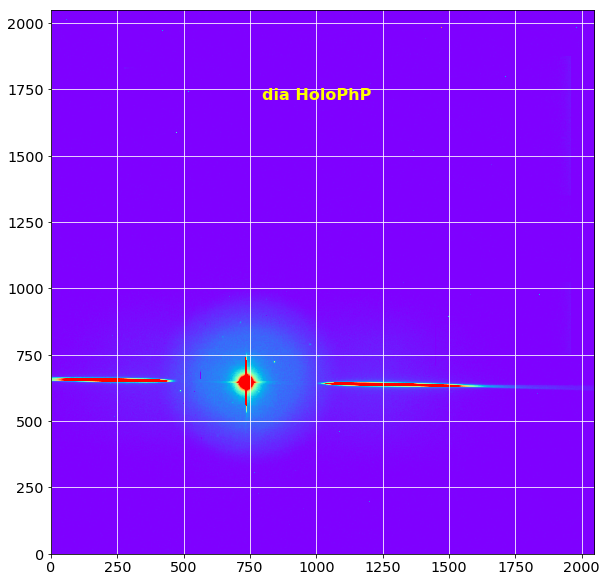

In [15]:
plt.figure(figsize=(10,10))
plt.imshow(all_images[sel_index],origin='lower',cmap='rainbow',vmin=0, vmax=2000)
plt.grid(color='white', ls='solid')
plt.text(1000.,1700,all_filt[sel_index],verticalalignment='bottom', horizontalalignment='center',color='yellow', fontweight='bold',fontsize=16)

### Try to fit a 2D gaussian

- Fit a 2D gaussian on intensity of central star


we have to paly with the parameter below to find a common region to find the central star

In [16]:
# first rough estimate of the maximum
x0,y0=guess_init_fit(all_images[sel_index],500,1100,500,1100)

In [17]:
dw=200  # width

In [18]:
print "x0,y0=",x0,y0

x0,y0= 734 641


In [19]:
# cut the subimage
cropped_image=np.copy(all_images[sel_index][y0-dw:y0+dw,x0-dw:x0+dw])

In [20]:
NY=cropped_image.shape[0]
NX=cropped_image.shape[1]

In [21]:
# build a mesh grid of x-y
y, x = np.mgrid[:NY,:NX]

In [22]:
z=cropped_image[y,x]

### Show the pre-selected subimage

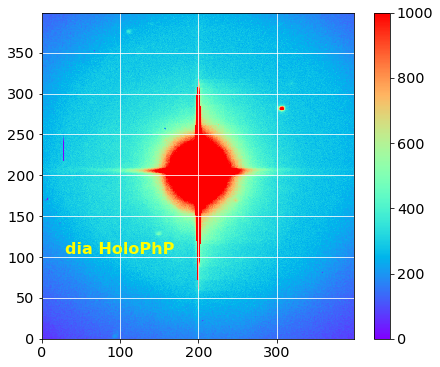

In [23]:
# plot x,y,z
plt.figure(figsize=(7,6))
plt.pcolormesh(x, y, z,cmap='rainbow',vmin=0, vmax=1000)
plt.grid(color='white', ls='solid')
plt.colorbar()
plt.text(100.,100,all_filt[sel_index],verticalalignment='bottom', horizontalalignment='center',color='yellow', fontweight='bold',fontsize=16)

In [24]:
x_mean=NX/2
y_mean=NY/2
z_max=z[y_mean,x_mean]
print x_mean,y_mean,z_max

200 200 60975.3101003


### Make the 2D fit

In [25]:
p_init = models.Gaussian2D(amplitude=z_max,x_mean=x_mean,y_mean=y_mean)
fit_p = fitting.LevMarLSQFitter()

In [26]:
import warnings
p = fit_p(p_init, x, y, z)

In [27]:
print p.x_mean
print p.y_mean
print p.amplitude

Parameter('x_mean', value=200.024005459)
Parameter('y_mean', value=201.421975634)
Parameter('amplitude', value=82413.2700843)


In [28]:
new_x0=p.x_mean
new_y0=p.y_mean

### Show result of 2D gaussian fit

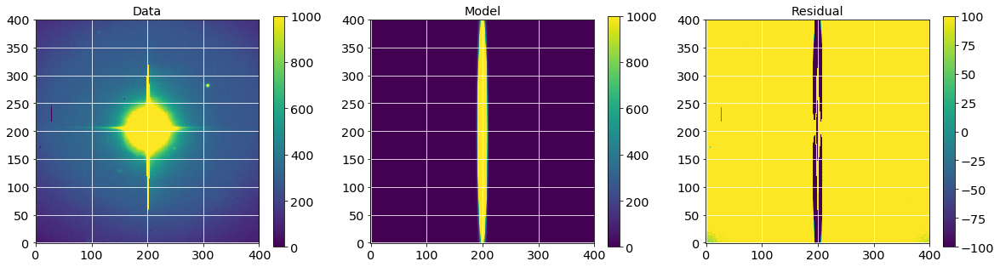

In [29]:
plt.figure(figsize=(20, 5))
#subplot 1
plt.subplot(1, 3, 1)
plt.imshow(z, origin='lower', interpolation='nearest', vmin=0, vmax=1000)
plt.grid(color='white', ls='solid')
plt.colorbar()
plt.title("Data")
#subplot 2
plt.subplot(1, 3, 2)
plt.imshow(p(x, y), origin='lower', interpolation='nearest', vmin=0,vmax=1000)
plt.grid(color='white', ls='solid')
plt.colorbar()
plt.title("Model")
#subplot 3
plt.subplot(1, 3, 3)
plt.imshow(z - p(x, y), origin='lower', interpolation='nearest', vmin=-100,vmax=100)
plt.grid(color='white', ls='solid')
plt.colorbar()
plt.title("Residual")

### Check the result of the fit

- the center of the star is where it is expected (black point)

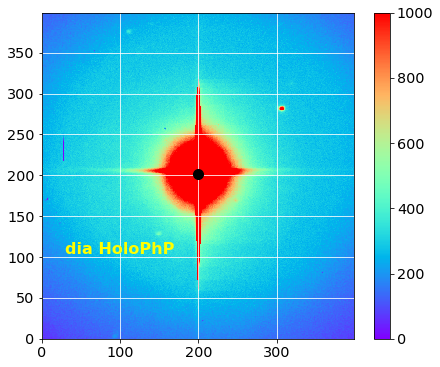

In [30]:
plt.figure(figsize=(7,6))
plt.pcolormesh(x, y, z,cmap='rainbow',vmin=0, vmax=1000)
plt.plot([new_x0],[new_y0],'ko',markersize=10)
plt.grid(color='white', ls='solid')
plt.colorbar()
plt.text(100.,100,all_filt[sel_index],verticalalignment='bottom', horizontalalignment='center',color='yellow', fontweight='bold',fontsize=16)

## Show the images at Input

- So now work on the series of the images

- First look at them
- notice there is a downsampling factor of 10

Processing image 0...
Processing image 1...
Processing image 2...
Processing image 3...
Processing image 4...
Processing image 5...
Processing image 6...
Processing image 7...
Processing image 8...
Processing image 9...
Processing image 10...
Processing image 11...
Processing image 12...
Processing image 13...
Processing image 14...
Processing image 15...
Processing image 16...
Processing image 17...
Processing image 18...
Processing image 19...
Processing image 20...
Processing image 21...
Processing image 22...
Processing image 23...
Processing image 24...
Processing image 25...
Processing image 26...
Processing image 27...
Processing image 28...
Processing image 29...
Processing image 30...
Processing image 31...
Processing image 32...
Processing image 33...
Processing image 34...
Processing image 35...
Processing image 36...
Processing image 37...
Processing image 38...
Processing image 39...
Processing image 40...
Processing image 41...
Processing image 42...
Processing image 43..

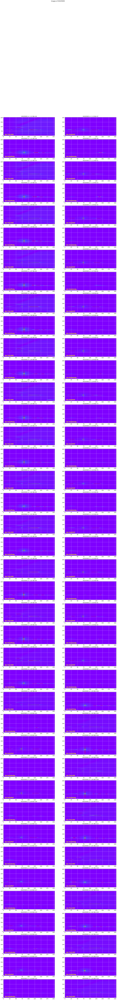

In [31]:
ShowImages(all_images,all_titles,all_filt,object_name,NBIMGPERROW=2,vmin=0,vmax=10000,downsampling=10,verbose=True)

figfilename=os.path.join(dir_top_images,'input_images.pdf')
plt.savefig(figfilename)   

## Show the histograms of input images

- just check the reduction and deflattage is OK

Processing image 0...
Processing image 1...
Processing image 2...
Processing image 3...
Processing image 4...
Processing image 5...
Processing image 6...
Processing image 7...
Processing image 8...
Processing image 9...
Processing image 10...
Processing image 11...
Processing image 12...
Processing image 13...
Processing image 14...
Processing image 15...
Processing image 16...
Processing image 17...
Processing image 18...
Processing image 19...
Processing image 20...
Processing image 21...
Processing image 22...
Processing image 23...
Processing image 24...
Processing image 25...
Processing image 26...
Processing image 27...
Processing image 28...
Processing image 29...
Processing image 30...
Processing image 31...
Processing image 32...
Processing image 33...
Processing image 34...
Processing image 35...
Processing image 36...
Processing image 37...
Processing image 38...
Processing image 39...
Processing image 40...
Processing image 41...
Processing image 42...
Processing image 43..

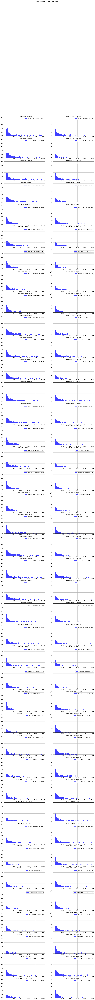

In [32]:
ShowHistograms(all_images,all_titles,all_filt,object_name,
               NBIMGPERROW=2,bins=100,range=(-50,10000),downsampling=10,verbose=True)

##  Guess central position of the central star in original image

- defines two utility functions


### Compute the position of central star

In [35]:
# guess the region where the maximum is
Delta_x0=[500,1100]
Delta_y0=[500,1100]
dwc=200

x_guess,y_guess=guess_central_position(all_images,Delta_x0,Delta_y0,dwc,filt0_idx,filt1_idx,filt2_idx,filt3_idx,filt4_idx,filt5_idx)

0 : (x_guess,y_guess)= 734.26321588 647.434766963
1 : (x_guess,y_guess)= 734.024005459 642.421975634
2 : (x_guess,y_guess)= 824.18060774 584.60186541
3 : (x_guess,y_guess)= 823.627446762 585.839916349
4 : (x_guess,y_guess)= 731.749797314 645.557406725
5 : (x_guess,y_guess)= 732.665592338 640.906622444
6 : (x_guess,y_guess)= 822.733045224 577.598261187
7 : (x_guess,y_guess)= 821.857423292 583.313213435
8 : (x_guess,y_guess)= 732.137157412 643.196787295
9 : (x_guess,y_guess)= 731.459967841 633.256615795
10 : (x_guess,y_guess)= 822.317702429 575.332381454
11 : (x_guess,y_guess)= 820.372750649 580.622985818
12 : (x_guess,y_guess)= 730.7015774 641.156817131
13 : (x_guess,y_guess)= 730.943717906 629.024095812
14 : (x_guess,y_guess)= 821.006005683 575.84313323
15 : (x_guess,y_guess)= 820.414534609 579.264786744
16 : (x_guess,y_guess)= 729.613831989 639.691688819
17 : (x_guess,y_guess)= 728.698932252 633.12311989
18 : (x_guess,y_guess)= 820.137825963 576.755826609
19 : (x_guess,y_guess)= 819.4

/Users/dagoret/anaconda/lib/python2.7/site-packages/matplotlib/pyplot.py:524: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


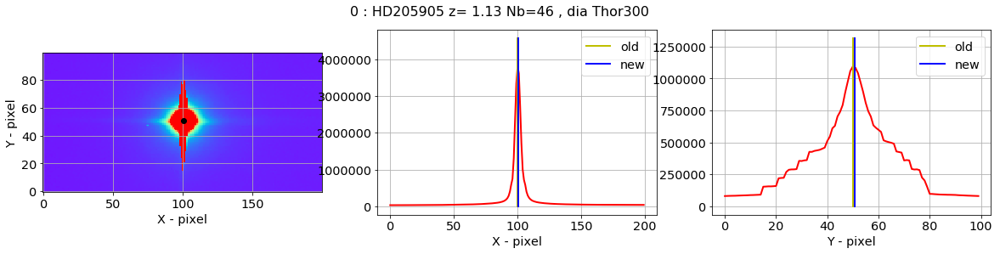

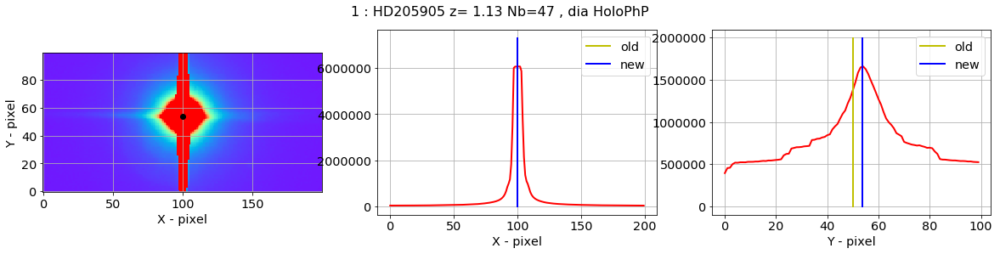

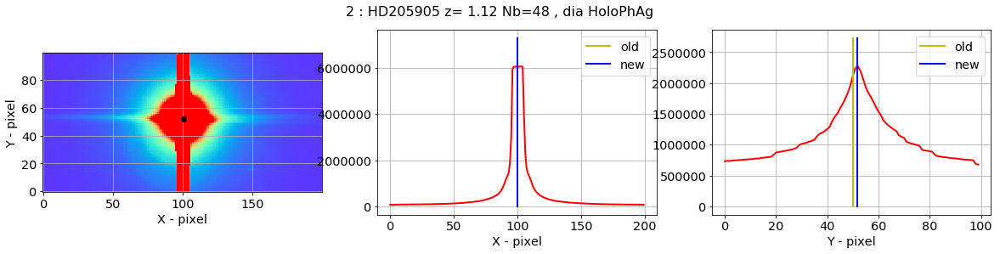

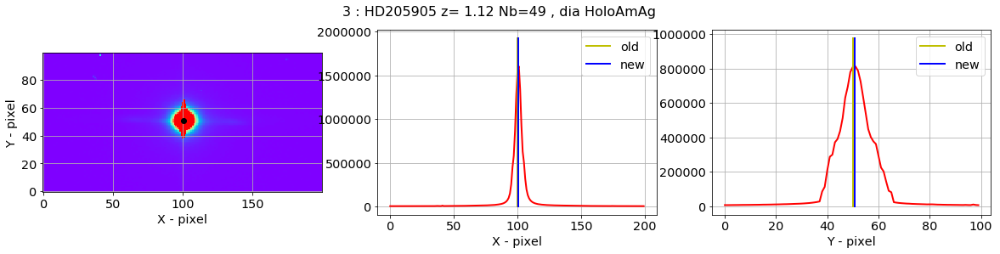

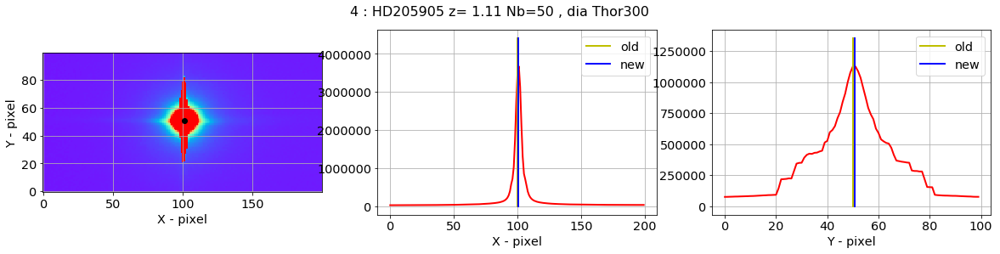

...

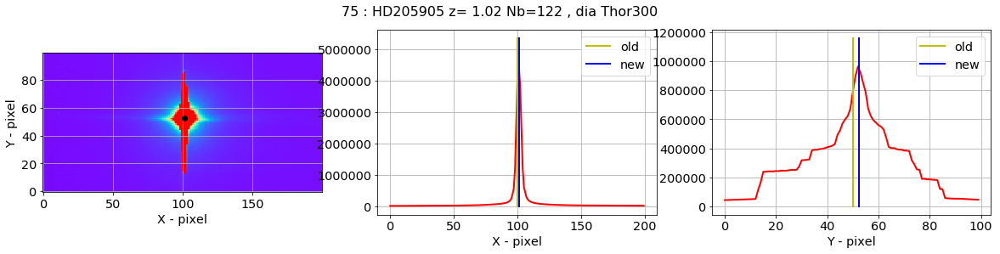

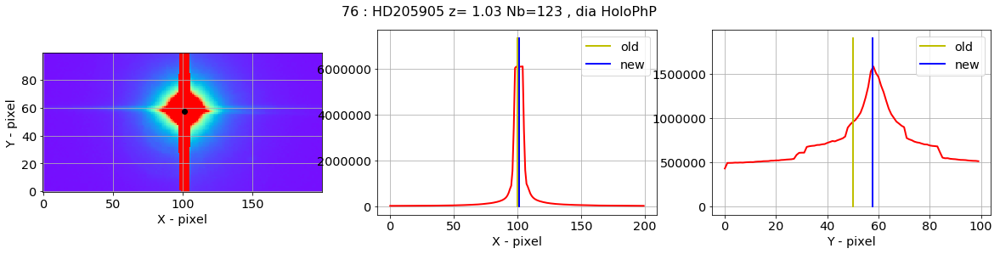

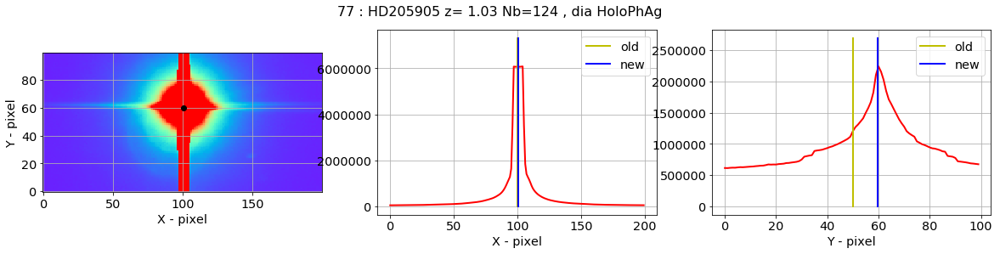

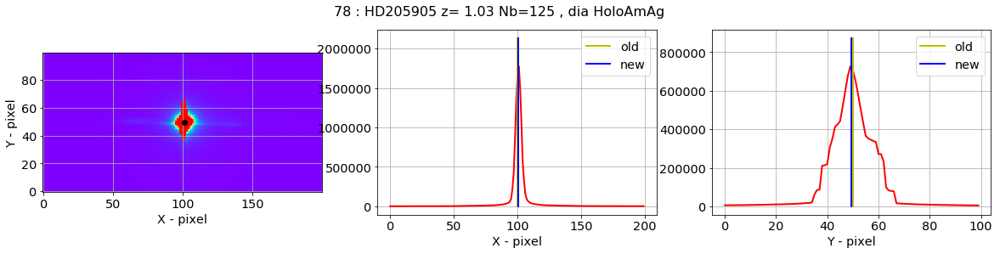

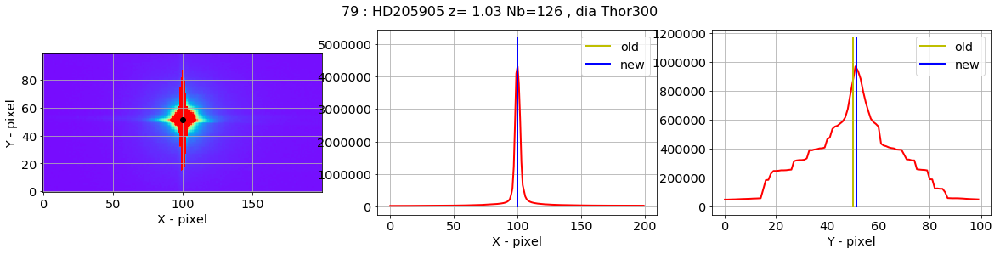

In [36]:
new_x_guess,new_y_guess=check_central_star(all_images,x_guess,y_guess,all_titles,all_filt,Dx=100,Dy=50)

### Check corrections of the center

In [38]:
dx_guess=new_x_guess-x_guess
dy_guess=new_y_guess-y_guess

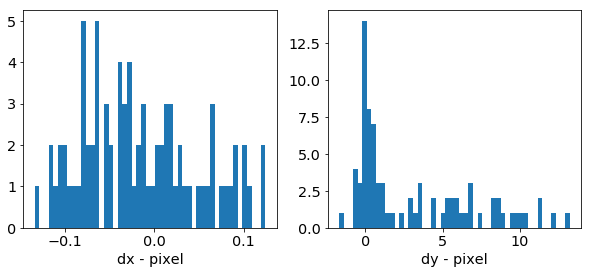

In [39]:
f, (ax1, ax2) = plt.subplots(1,2, figsize=(10,4))
ax1.hist(dx_guess,bins=50);
ax1.set_xlabel("dx - pixel")
ax2.hist(dy_guess,bins=50);
ax2.set_xlabel("dy - pixel")

In [40]:
x_guess=new_x_guess
y_guess=new_y_guess

## Save x_guess, y_guess in a file

In [41]:
ar = {'x_guess' : x_guess, 'y_guess' : y_guess}
df = pd.DataFrame(ar)

In [42]:
df.head()

,x_guess,y_guess
0,734.200949,647.719075
1,733.994455,645.712814
2,824.112296,585.786300
3,823.588894,585.639502
4,731.701102,645.702776


In [43]:
df.tail()

,x_guess,y_guess
75,702.882947,614.377101
76,704.012567,612.533738
77,792.508908,552.759494
78,790.697541,553.479712
79,700.934702,613.310734


In [44]:
df.describe()

,x_guess,y_guess
count,80.000000,80.000000
mean,764.659538,598.418233
std,46.607499,32.205660
min,700.934702,552.747507
25%,722.415125,567.477515
50%,762.449245,599.160019
75%,811.232403,627.968371
max,824.112296,647.719075


In [45]:
df.to_csv('x_y_guess.csv')

## Finally cut image

- before rotation

- cut the image around the spectra
- the width in Y is DeltaY=100 pixel above and down

In [46]:
DeltaY=[100]*len(all_images)
DeltaX=[2000]*len(all_images)  # must be very large to have correct x positions

images_raw=ShowCenterImages(x_guess,y_guess,DeltaX,DeltaY,all_images,all_titles,all_filt,object_name,NBIMGPERROW=2,vmin=0,vmax=2000,target_pos=np.array([x_guess,y_guess]).T)
figfilename=os.path.join(dir_top_images,'cut_images.pdf')
plt.savefig(figfilename)   

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


## Save cut images
------------------------

- save the series of cut images called **images_raw** in a file


In [47]:
newfullfilenames=[]
for idx,f in np.ndenumerate(sorted_files):
    short_infilename=f.split("/")[-1]
    short_partfilename=re.findall('^%s_(.*)' % tag,short_infilename)
    short_outfilename='cutimg_'+short_partfilename[0]
    newfullfilename=os.path.join(outputdir,short_outfilename)
    newfullfilenames.append(newfullfilename)
    
for idx,f in np.ndenumerate(newfullfilenames):
    prihdu = fits.PrimaryHDU(header=all_header[idx[0]],data=images_raw[idx[0]])
    thdulist = fits.HDUList(prihdu)
    thdulist.writeto(f,overwrite=True)

!ls -l cut_fitsimages/*

-rw-r--r--  1 dagoret  LAL\Utilisateurs du domaine  3288960 Oct  6 12:35 cut_fitsimages/cutimg_20170605_046.fits
-rw-r--r--  1 dagoret  LAL\Utilisateurs du domaine  3288960 Oct  6 12:35 cut_fitsimages/cutimg_20170605_047.fits
-rw-r--r--  1 dagoret  LAL\Utilisateurs du domaine  3288960 Oct  6 12:35 cut_fitsimages/cutimg_20170605_048.fits
-rw-r--r--  1 dagoret  LAL\Utilisateurs du domaine  3288960 Oct  6 12:35 cut_fitsimages/cutimg_20170605_049.fits
-rw-r--r--  1 dagoret  LAL\Utilisateurs du domaine  3288960 Oct  6 12:35 cut_fitsimages/cutimg_20170605_050.fits
-rw-r--r--  1 dagoret  LAL\Utilisateurs du domaine  3288960 Oct  6 12:35 cut_fitsimages/cutimg_20170605_051.fits
-rw-r--r--  1 dagoret  LAL\Utilisateurs du domaine  3288960 Oct  6 12:35 cut_fitsimages/cutimg_20170605_052.fits
-rw-r--r--  1 dagoret  LAL\Utilisateurs du domaine  3288960 Oct  6 12:35 cut_fitsimages/cutimg_20170605_053.fits
-rw-r--r--  1 dagoret  LAL\Utilisateurs du domaine  3288960 Oct  6 12:35 cut_fitsimages/cutimg_2

---------------------------------------------------------------------------------
# Section 2 : Find the rotation angle and apply rotation
----------------------------------------------------------------------------------

## Initialisation of Section 2
----------------------------------

In [48]:
inputdir="./cut_fitsimages"
SelectTagRe='^cutimg_%s_([0-9]+).fits$' % date # regular expression to select the file
SearchTagRe='^cutimg_%s_[0-9]+.fits$' % date

outputdir="./rotated_fitsimages"
ensure_dir(outputdir)

sorted_numbers,sorted_files = MakeFileList([inputdir],MIN_IMGNUMBER,MAX_IMGNUMBER,SelectTagRe,SearchTagRe) 

all_dates,all_airmass,all_images,all_titles,all_header,all_expo,all_filt=BuildImages(sorted_files,sorted_numbers,object_name)

print 'Number of images:',len(all_images)

Number of images: 80


In [49]:
filt0_idx,filt1_idx,filt2_idx,filt3_idx,filt4_idx,filt5_idx,filt6_idx=get_filt_idx(all_filt)

In [50]:
df=pd.read_csv('x_y_guess.csv')
x_guess=df["x_guess"]
y_guess=df["y_guess"]
DeltaY=[100]*len(all_images)

In [51]:
df.head()

,Unnamed: 0,x_guess,y_guess
0,0,734.200949,647.719075
1,1,733.994455,645.712814
2,2,824.112296,585.786300
3,3,823.588894,585.639502
4,4,731.701102,645.702776


## Find rotation by Hessian analysis

La méthode s'inspire des techniques de détection de filmanents dans le milieu interstellaire.
Elle est décrite dans https://arxiv.org/pdf/1409.6728.pdf section 4.1.
Documentation sur le calcul du Hessien : http://scikit-image.org/docs/dev/api/skimage.feature.html#skimage.feature.hessian_matrix

### Test rotation optimal settings

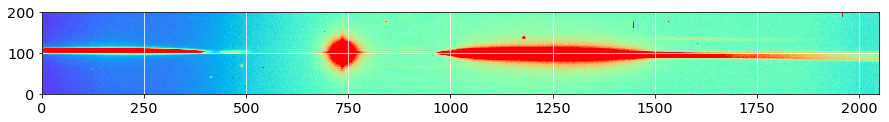

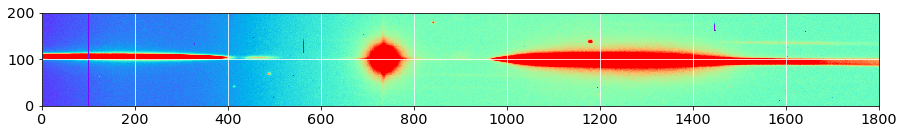

In [52]:
sel=0
image_sel=np.copy(all_images[sel])
y0=DeltaY[sel]
x0=x_guess[sel]

width_cut = 100
right_edge = 1800

plt.imshow(image_sel,origin='lower',cmap='rainbow',vmin=-10,vmax=800)
plt.grid(color='white', ls='solid')
plt.show()

region=np.copy(image_sel[y0-width_cut:y0+width_cut,0:right_edge])
data=np.copy(region)
plt.imshow(data,origin='lower',cmap='rainbow',vmin=-10,vmax=800)
plt.grid(color='white', ls='solid')
plt.show()

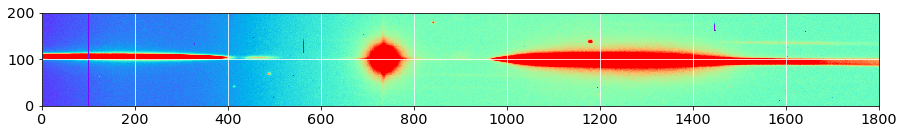

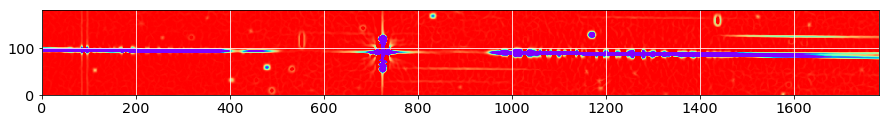

In [53]:
# le paramètre sigma permet de lisser le hessien
Hxx, Hxy, Hyy = hessian_matrix(data, sigma=3, order = 'xy')
lambda_plus = 0.5*( (Hxx+Hyy) + np.sqrt( (Hxx-Hyy)**2 +4*Hxy*Hxy) )
lambda_minus = 0.5*( (Hxx+Hyy) - np.sqrt( (Hxx-Hyy)**2 +4*Hxy*Hxy) )
theta = 0.5*np.arctan2(2*Hxy,Hyy-Hxx)*180/np.pi

margin_cut = 10

lambda_minus = lambda_minus[margin_cut:-margin_cut,margin_cut:-margin_cut]
lambda_plus = lambda_plus[margin_cut:-margin_cut,margin_cut:-margin_cut]
theta = theta[margin_cut:-margin_cut,margin_cut:-margin_cut]

plt.imshow(data,origin='lower',cmap='rainbow',vmin=-10,vmax=800)
plt.grid(color='white', ls='solid')
plt.show()
plt.imshow(lambda_minus,origin='lower',cmap='rainbow',vmin=-10,vmax=0)
plt.grid(color='white', ls='solid')
plt.show()

Number of remaining pixels : 20015


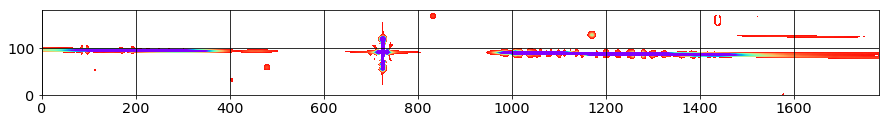

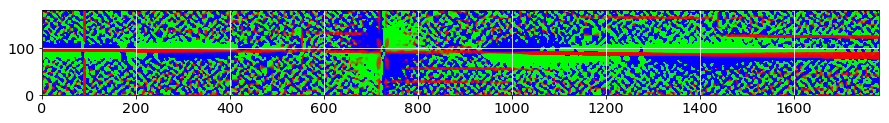

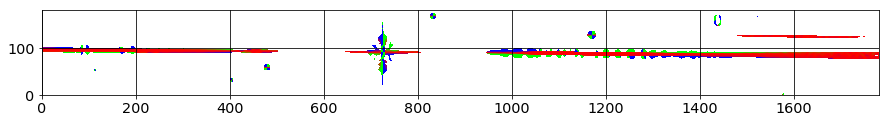

In [54]:
lambda_threshold = -2

mask = np.where(lambda_minus>lambda_threshold)
lambda_mask = np.copy(lambda_minus)
lambda_mask[mask]=np.nan

theta_mask = np.copy(theta)
theta_mask[mask]=np.nan

print 'Number of remaining pixels :',len(lambda_mask[~np.isnan(lambda_mask)])

plt.imshow(lambda_mask,origin='lower',cmap='rainbow',vmin=-100,vmax=0)
plt.grid(color='black', ls='solid')
plt.show()

plt.imshow(theta,origin='lower',cmap=cm.brg,vmin=-30,vmax=30)
plt.grid(color='white', ls='solid')
plt.show()

plt.imshow(theta_mask,origin='lower',cmap=cm.brg,vmin=-30,vmax=30)
plt.grid(color='black', ls='solid')
plt.show()

Number of remaining pixels : 14442


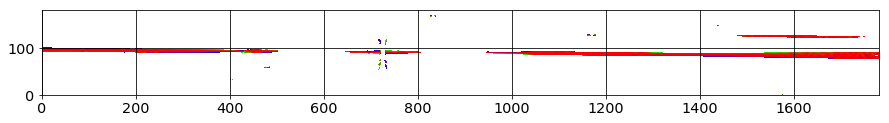

In [55]:
deg_threshold = 20

mask2 = np.where(np.abs(theta)>deg_threshold)
theta_mask[mask2] = np.nan
print 'Number of remaining pixels :',len(theta_mask[~np.isnan(theta_mask)])
plt.imshow(theta_mask,origin='lower',cmap=cm.brg,vmin=-deg_threshold,vmax=deg_threshold)
plt.grid(color='black', ls='solid')
plt.show()

Angle median : -0.470009089806


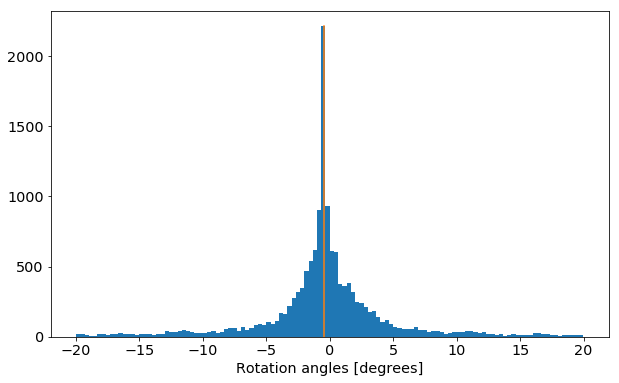

In [56]:
theta_hist = []
theta_hist = theta_mask[~np.isnan(theta_mask)].flatten()
theta_median = np.median(theta_hist)
print 'Angle median :',theta_median
fig = plt.figure(figsize=(10,6))
n,bins, patches = plt.hist(theta_hist,bins=int(np.sqrt(len(theta_hist))))
plt.plot([theta_median,theta_median],[0,np.max(n)])
plt.xlabel("Rotation angles [degrees]")
plt.show()

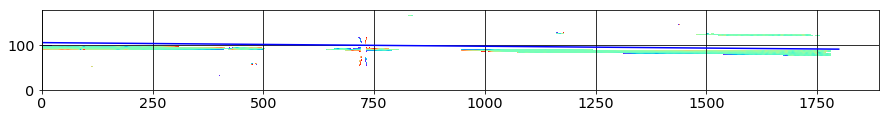

In [57]:
xindex=np.arange(data.shape[1])
x_new = np.linspace(xindex.min(),xindex.max(), 50)
#y_new = y0 - width_cut + (x_new-x0)*np.tan(theta_median*np.pi/180.)
# really want to see of hessian an straight line math SDC : Sept 25 2017
y_new = y0   + (x_new-x0)*np.tan(theta_median*np.pi/180.)
plt.imshow(theta_mask,origin='lower',cmap='rainbow',vmin=-deg_threshold,vmax=deg_threshold)
plt.plot(x_new,y_new,'b-')
plt.grid(color='black', ls='solid')
plt.show()


Rotation angle from fit : -0.0503447241705


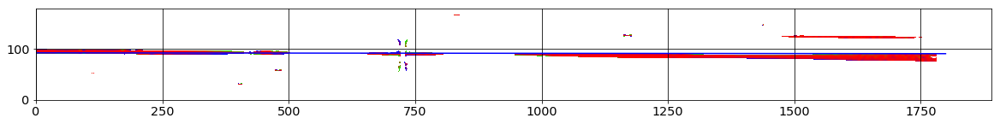

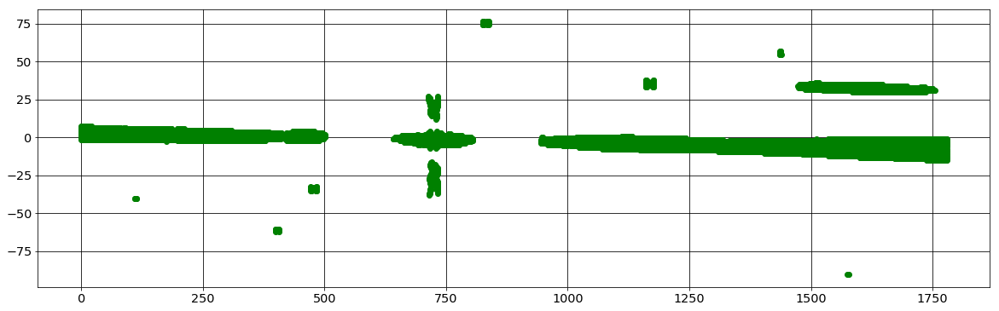

In [58]:
xtofit=[]
ytofit=[]
for iy,y in enumerate(theta_mask):
    for ix,x in enumerate(y):
        if not np.isnan(theta_mask[iy][ix]) :
            if np.abs(theta_mask[iy][ix])>deg_threshold : continue
            xtofit.append(ix)
            ytofit.append(iy)
popt, pcov = fit_line(xtofit, ytofit)
[a, b] = popt
x_new = np.linspace(xindex.min(),xindex.max(), 50)
y_new = line(x_new,a,b)
print 'Rotation angle from fit :',np.arctan(a)*180/np.pi
fig = plt.figure(figsize=[20,6])
plt.imshow(theta_mask,origin='lower',cmap=cm.brg,vmin=-deg_threshold,vmax=deg_threshold)
plt.plot(x_new,y_new,'b-')
plt.grid(color='black', ls='solid')
plt.show()
fig = plt.figure(figsize=[20,6])
diff = []
for ix,x in enumerate(xtofit):
    diff.append(ytofit[ix]-line(x,a,b))
plt.plot(xtofit,diff,'go')
plt.grid(color='black', ls='solid')
plt.show()

Using Hessian theta angles:
0  theta =  -0.47222993739
1  theta =  -0.966580508048
2  theta =  -1.89716032655
3  theta =  -1.41772612896
4  theta =  -0.47998432295
5  theta =  -0.974238961744
6  theta =  -1.90732502321
7  theta =  -1.44398056637
8  theta =  -0.453661565407
9  theta =  -0.956867150278
10  theta =  -1.88905589911
11  theta =  -1.45443986739
12  theta =  -0.44472615403
13  theta =  -0.99567245485
14  theta =  -1.91350077742
15  theta =  -1.47341061551
16  theta =  -0.473608450208
17  theta =  -0.966980659061
18  theta =  -1.91430433276
19  theta =  -1.46723087792
20  theta =  -0.450804274729
21  theta =  -0.96471667072
22  theta =  -1.93345768804
23  theta =  -1.50089885114
24  theta =  -0.467014533692
25  theta =  -0.97833772015
26  theta =  -1.91341904321
27  theta =  -1.46002597995
28  theta =  -0.440967763505
29  theta =  -0.983596721167
30  theta =  -1.91303599651
31  theta =  -1.49210983375
32  theta =  -0.484053277745
33  theta =  -0.991442115556
34  theta =  -1.94

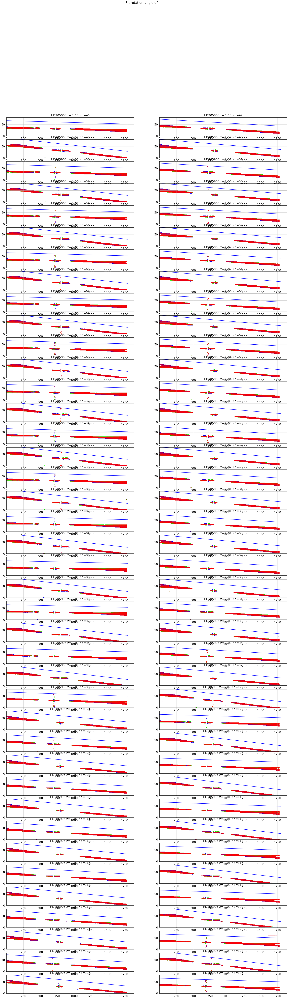

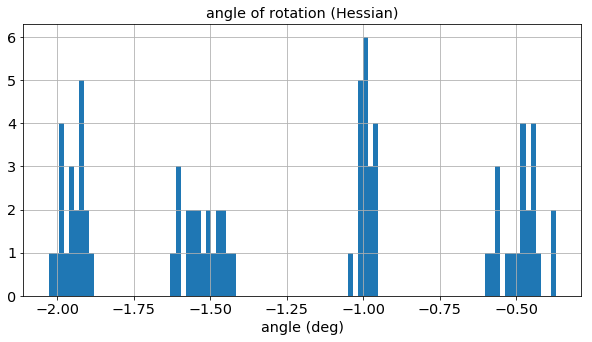

In [59]:
print 'Using Hessian theta angles:'

all_theta=ComputeRotationAngleHessian(all_images,x_guess,DeltaY,all_titles,object_name, 
    NBIMGPERROW=2, lambda_threshold = -2, deg_threshold = 20, width_cut = 40, right_edge = 1800, margin_cut = 10)
figfilename=os.path.join(dir_top_images,'fit_rotation.pdf')
plt.savefig(figfilename)  

for index in range(len(all_theta)):
    print index,' theta = ',all_theta[index]
plt.figure(figsize=(10,5))
n, bins, patches=plt.hist(all_theta,bins=100,histtype='stepfilled')
plt.grid(True)
plt.title('angle of rotation (Hessian)')
plt.xlabel('angle (deg)')

## Turn the images accordingly

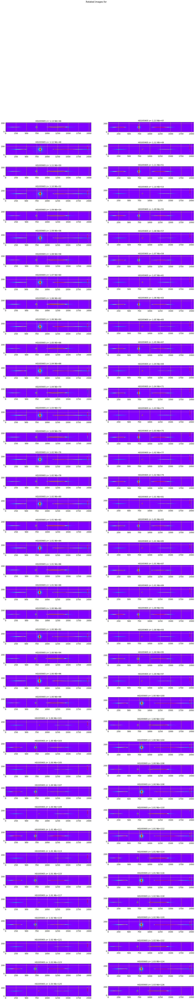

In [60]:
turned_images=TurnTheImages(all_images,all_theta,all_titles,object_name,
                            NBIMGPERROW=2,vmin=500,vmax=10000,oversample_factor=1)
figfilename=os.path.join(dir_top_images,'rotated_images.pdf')
plt.savefig(figfilename)  

## Check rotations

array([ 0.01143583,  0.03917245, -0.0529674 ,  0.0179103 , -0.01268525,
        0.02066086, -0.03807918,  0.01792976, -0.02468822, -0.00536724,
       -0.03475873,  0.04602824,  0.00558953,  0.04727036, -0.04922512,
        0.04222106,  0.01089402,  0.01885131, -0.04619787,  0.03779792,
       -0.00495305,  0.04006211, -0.04949449,  0.03920835,  0.00845106,
        0.03438207, -0.04844811,  0.01069496,  0.01295927,  0.04673905,
       -0.04529153,  0.0051764 ,  0.00599216,  0.02005557, -0.041702  ,
        0.02808032, -0.02619573,  0.04605582, -0.01743347,  0.04642006,
       -0.00029577,  0.0210563 , -0.02097964,  0.04685708, -0.01254229,
        0.02873336, -0.06698308,  0.0161362 ,  0.00728518,  0.01346462,
       -0.0292235 ,  0.00599546,  0.00039037, -0.01226837,  0.03638426,
        0.02182226,  0.0417911 , -0.04646281,  0.03407203,  0.00066219,
        0.03198958, -0.02674037,  0.03051126, -0.01296988,  0.04036304,
       -0.01580253,  0.03116187, -0.00036853,  0.00746571, -0.06

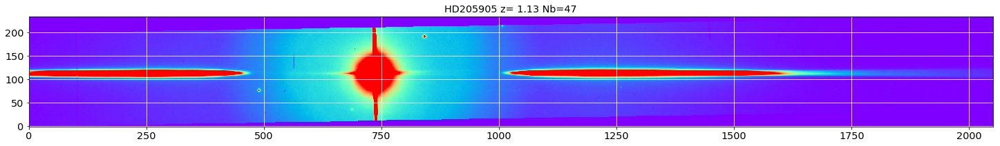

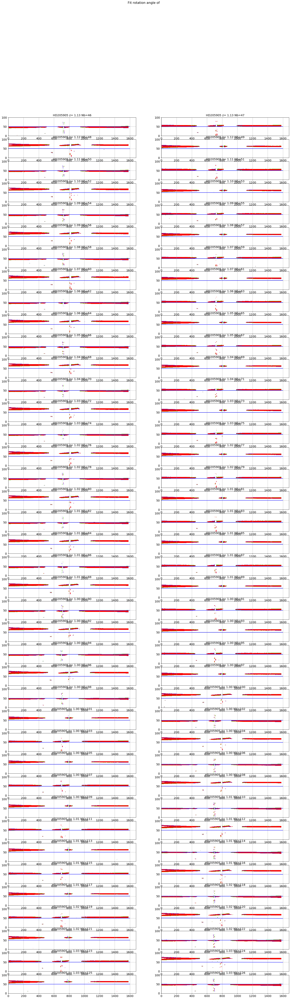

In [61]:
sel=1
plt.figure(figsize=(25,10))
plt.imshow(turned_images[sel],origin='lower',cmap='rainbow',vmin=0,vmax=1000)
plt.grid(True)
plt.title(all_titles[sel])
plt.grid(color='white', ls='solid')
figfilename=os.path.join(dir_top_images,'rotated_image_sample.pdf')
plt.savefig(figfilename)  

ComputeRotationAngleHessian(turned_images,x_guess,DeltaY,all_titles,object_name,
    NBIMGPERROW=2, lambda_threshold = -2, deg_threshold = 20, width_cut = 50, right_edge = 1600, margin_cut = 10)

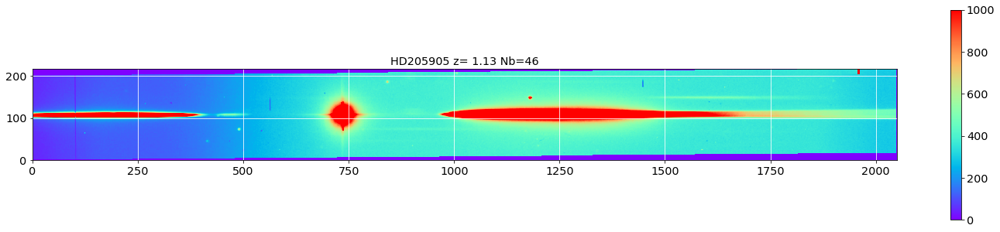

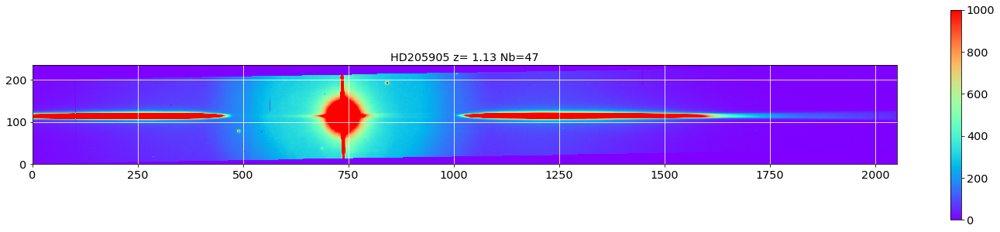

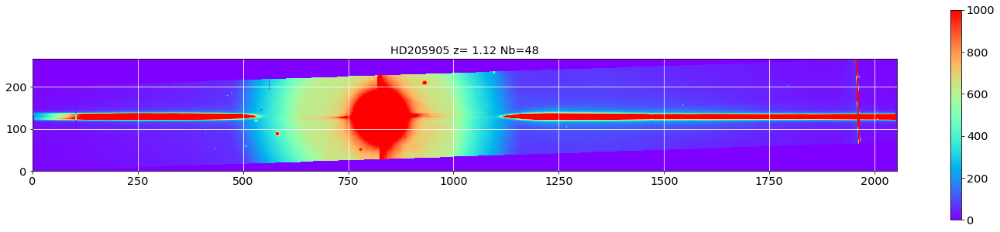

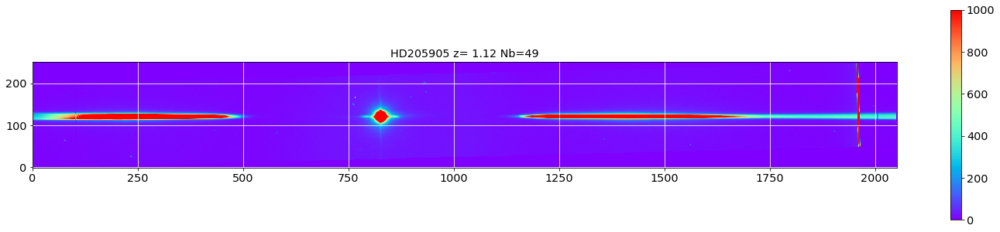

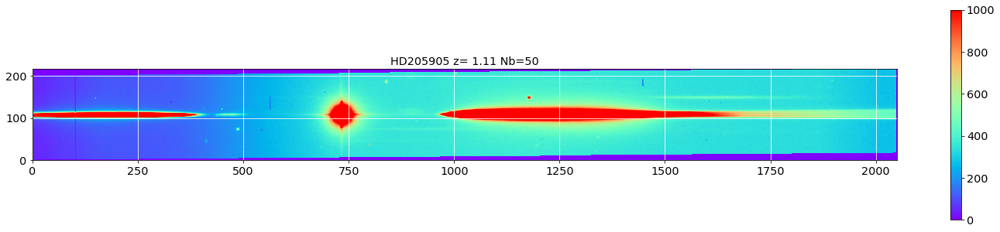

...

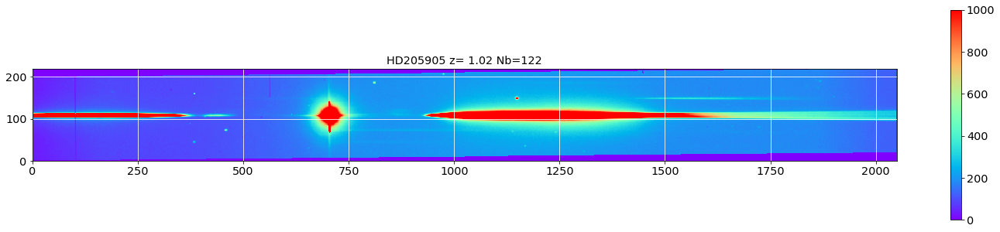

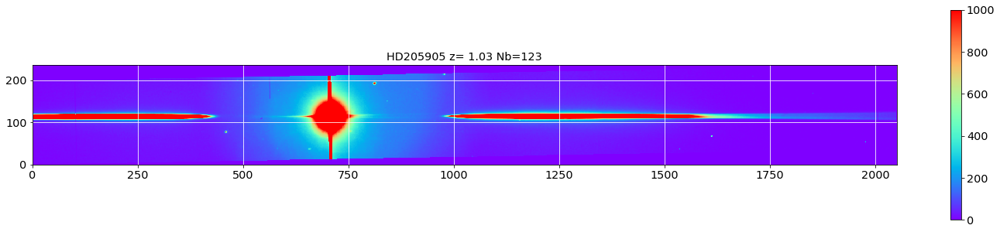

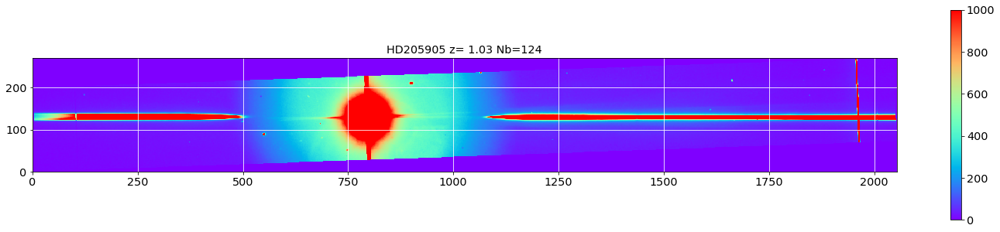

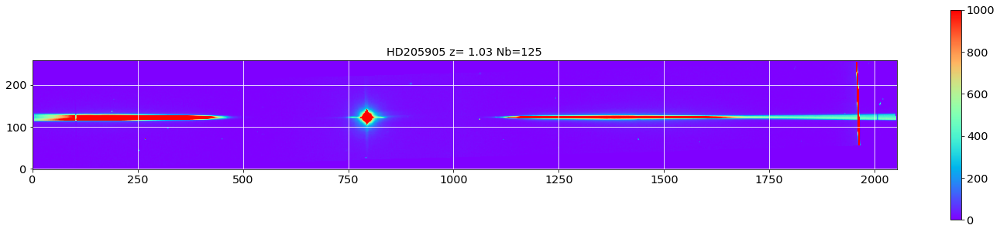

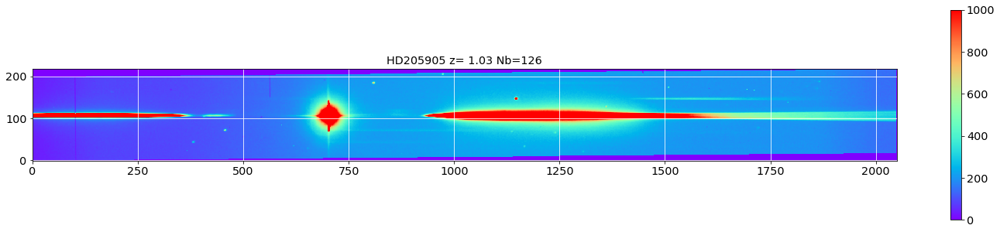

In [62]:
debug=True
if debug:
    for sel in range(len(turned_images)):
        plt.figure(figsize=(25,5))
        plt.imshow(turned_images[sel],origin='lower',cmap='rainbow',vmin=0,vmax=1000)
        plt.grid(True)
        plt.title(all_titles[sel])
        plt.grid(color='white', ls='solid')
        plt.colorbar()

## Must guess again the new centers for rotation

In [63]:
# guess the region where the maximum is
Delta_x02=[500,1100]
Delta_y02=[50,150]
dwc2=40

In [64]:
turned_images[0].shape

(217, 2050)

In [65]:
guess_init_fit(turned_images[0],Delta_x02[0],Delta_x02[1],Delta_y02[0],Delta_y02[1])

(735, 107)

### Initial guess

In [66]:
x_guess2,y_guess2=guess_central_position(turned_images,Delta_x02,Delta_y02,dwc2,filt0_idx,filt1_idx,filt2_idx,filt3_idx,filt4_idx,filt5_idx)

0 : (x_guess,y_guess)= 735.271806153 106.59311746
1 : (x_guess,y_guess)= 735.654402072 113.2004135
2 : (x_guess,y_guess)= 826.84198864 128.187849106
3 : (x_guess,y_guess)= 825.659561961 121.388671401
4 : (x_guess,y_guess)= 732.757280786 106.617990333
5 : (x_guess,y_guess)= 734.331282901 113.881737251
6 : (x_guess,y_guess)= 826.041498483 128.661559179
7 : (x_guess,y_guess)= 823.906402661 121.240525724
8 : (x_guess,y_guess)= 733.148323012 105.863077197
9 : (x_guess,y_guess)= 732.978099291 114.254602314
10 : (x_guess,y_guess)= 825.031208884 128.232594312
11 : (x_guess,y_guess)= 822.435986496 120.481890987
12 : (x_guess,y_guess)= 731.210207568 105.926232904
13 : (x_guess,y_guess)= 732.529566212 113.599154919
14 : (x_guess,y_guess)= 824.270946436 128.252014603
15 : (x_guess,y_guess)= 822.464285064 121.542786395
16 : (x_guess,y_guess)= 730.617671592 106.758932928
17 : (x_guess,y_guess)= 730.289306838 113.215060536
18 : (x_guess,y_guess)= 823.313197744 127.924123551
19 : (x_guess,y_guess)= 82

### Check new guess of turned images

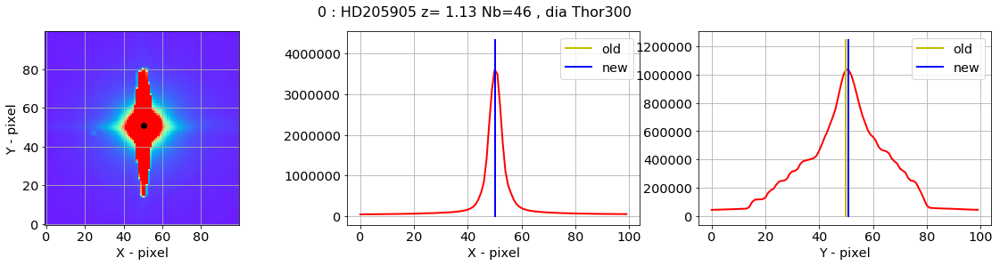

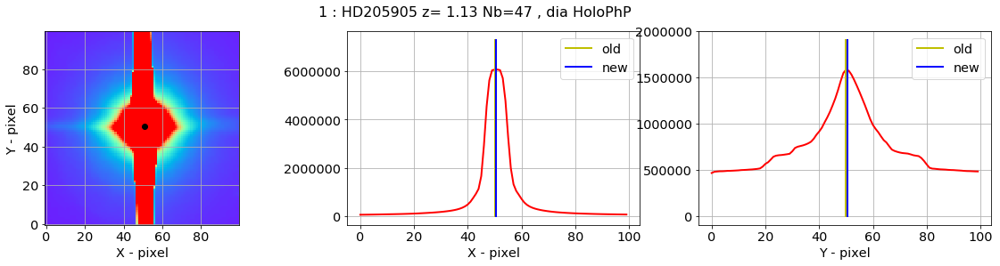

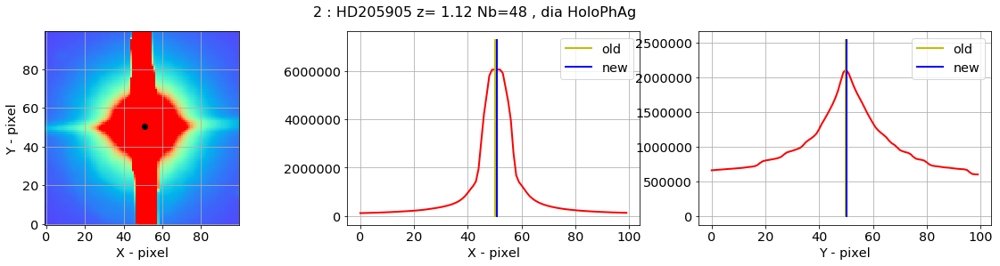

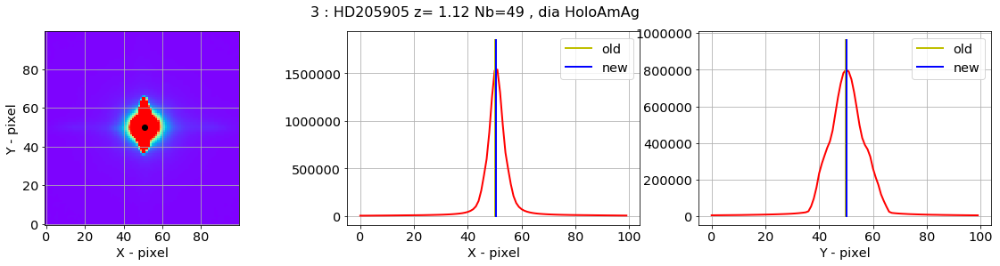

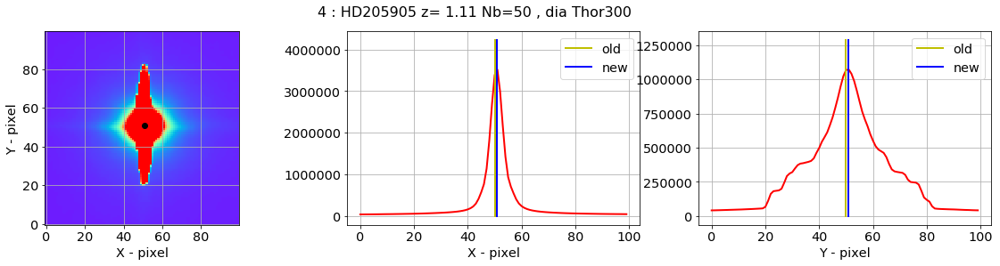

...

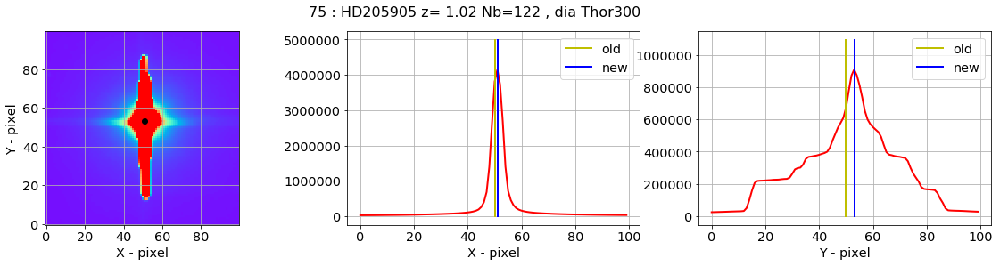

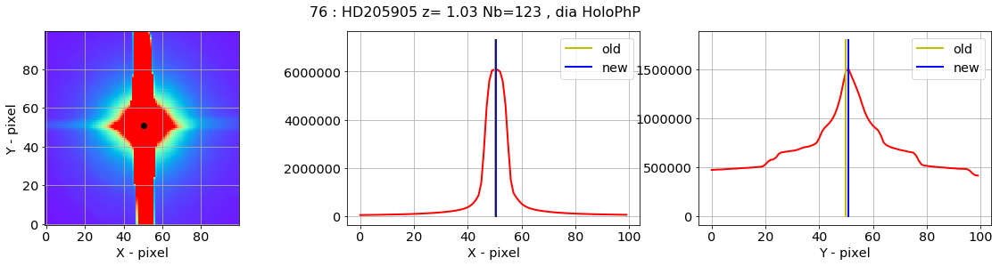

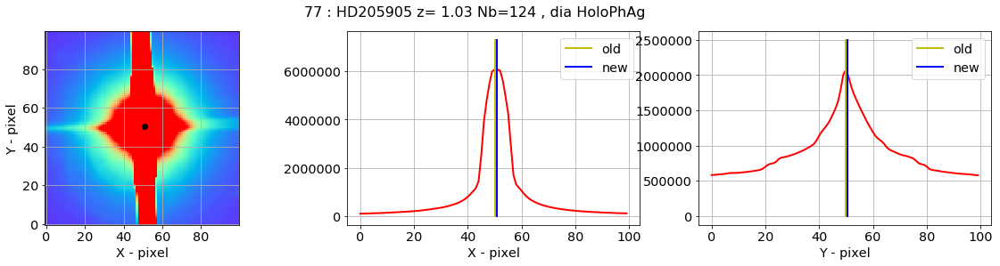

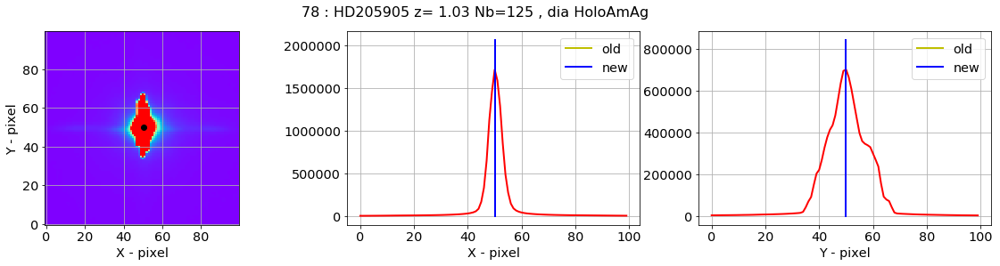

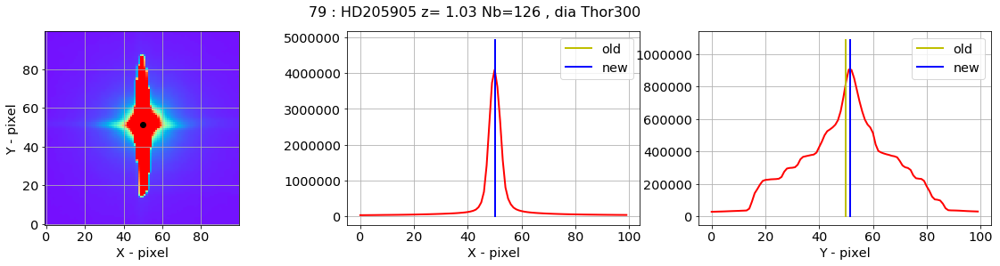

In [67]:
new_x_guess2,new_y_guess2=check_central_star(turned_images,x_guess2,y_guess2,all_titles,all_filt,Dx=50,Dy=50)

In [68]:
x_guess2=new_x_guess2
y_guess2=new_y_guess2

In [69]:
ar2 = {'x_guess2' :x_guess2, 'y_guess2' : y_guess2,'theta' :all_theta}
df2 = pd.DataFrame(ar2)

In [70]:
df2.head()

,theta,x_guess2,y_guess2
0,-0.472230,735.253647,106.836525
1,-0.966581,735.587069,113.552699
2,-1.897160,826.780529,128.344163
3,-1.417726,825.593652,121.198030
4,-0.479984,732.701053,106.762561


In [71]:
df2.to_csv('x_y_guess2.csv')

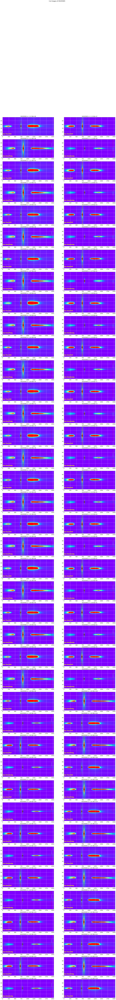

In [72]:
DeltaX=[2000]*len(all_images)
DeltaY_rot2 = [50]*len(all_images) # change from 20 to 50 to see well the central star
x_guess_rot2 = x_guess2
y_guess_rot2 = y_guess2
images_cut_rot=ShowCenterImages(x_guess_rot2,y_guess_rot2,DeltaX,DeltaY_rot2,
                    turned_images,all_titles,all_filt,object_name,NBIMGPERROW=2,vmin=0,vmax=10000,target_pos=np.array([x_guess2,y_guess2]).T) 

## Find the central star locations
======================================

### Central star positions after rotation and cut

In [73]:
# Not necessary to do this because already done
CompareBeforeAfterRotFlag=False

if CompareBeforeAfterRotFlag:

    x_guess_rot = x_guess2
    y_guess_rot = y_guess2
    DeltaY_rot = [100]*len(all_images)
    DeltaX_rot = [100]*len(all_images)
    # First stage : show the rotated images which were cut
    print 'First stage : show the rotated images which were cut'
    #--------------------------------------------------------------
    images_cut=ShowCenterImages(x_guess_rot,y_guess_rot,DeltaX_rot,DeltaY_rot,
                    images_cut_rot,all_titles,all_filt,object_name,NBIMGPERROW=2,vmin=0,vmax=10000,target_pos=np.array([x_guess2,y_guess2]).T) 
    # Second stage : show the images cut before they were cut
    print 'Second stage : show the images cut before they were cut'
    #----------------------------------------------------------------
    images_cut_before_rot=ShowCenterImages(x_guess,[100]*len(all_images),DeltaX_rot,DeltaY_rot,
                    all_images,all_titles,all_filt,object_name,NBIMGPERROW=2,vmin=0,vmax=10000,target_pos=np.array([x_guess,y_guess]).T) 

In [74]:
# DAOFind does not work for me (never)
DAOFindUseFlag=False
    
# (JN) valeurs optimisées pour cette étude
if DAOFindUseFlag:
    img_mean,img_median,img_std,img_sources=ComputeStatImages(images_cut,fwhm=10,threshold=10,sigma=5.0,iters=5)
    print 'total number of images',len(images_cut)
    print 'number of centroid found ',len(img_sources)

## Central star position

- should take the brightest

In [75]:
if DAOFindUseFlag:
    x_star = []
    y_star = []
    for index,s in enumerate(img_sources):
        for ss in s:
            x_star.append(ss['xcentroid']+x_guess_rot[index]-DeltaX_rot[index])
            y_star.append(ss['ycentroid']+y_guess_rot[index]-DeltaY_rot[index])
        
    x_mean = np.mean(x_star)
    y_mean = np.mean(y_star)
    img_size=all_images[0].shape
    plt.figure(figsize=(5,5))

    # plot individual image center
    plt.plot(x_star,y_star,'o')
    # plot the average postion
    plt.plot(x_mean,y_mean,'ro')
    plt.xlim(0,img_size[1])
    plt.ylim(0,img_size[0])
    plt.grid(True)
    
    print 'nuber of x_star = ',len(x_star)
    print 'nuber of y_star = ',len(y_star)

> The problem is that DAOFIND may not find a center for each source. Thys the only solution
is to do the same thing : computing the average depending on each filter.

In [76]:
if DAOFindUseFlag:
    x_star = []
    y_star = []

    x_star_f0 = []
    y_star_f0 = []

    x_star_f1 = []
    y_star_f1 = []

    x_star_f2 = []
    y_star_f2 = []

    x_star_f3 = []
    y_star_f3 = []

    x_star_f4 = []
    y_star_f4 = []

    missing_centroid = []
    missing_centroid_f0 = []
    missing_centroid_f1 = []
    missing_centroid_f2 = []
    missing_centroid_f3 = []
    missing_centroid_f4 = []


    # loop on all image- source
    for index,s in enumerate(img_sources):
        print "star number :",index
        if len(s) == 0:
            print '!! found no centroid'
            missing_centroid.append(index)
        
            if index in filt0_idx:
                missing_centroid_f0.append(index)
        
            if index in filt1_idx:
                missing_centroid_f1.append(index)
            
            if index in filt2_idx:
                missing_centroid_f2.append(index)   
            
            if index in filt3_idx:
                missing_centroid_f3.append(index)     

            if index in filt4_idx:
                missing_centroid_f4.append(index) 
            
        else:
            print 'found ',len(s),' centroid '
            # loop on individual sources in the image
            for ss in s:
                x_star.append(ss['xcentroid']+x_guess_rot[index]-DeltaX_rot[index])
                y_star.append(ss['ycentroid']+y_guess_rot[index]-DeltaY_rot[index])
            
                if index in filt0_idx:
                    x_star_f0.append(ss['xcentroid']+x_guess_rot[index]-DeltaX_rot[index])
                    y_star_f0.append(ss['ycentroid']+y_guess_rot[index]-DeltaY_rot[index])
        
                if index in filt1_idx:
                    x_star_f1.append(ss['xcentroid']+x_guess_rot[index]-DeltaX_rot[index])
                    y_star_f1.append(ss['ycentroid']+y_guess_rot[index]-DeltaY_rot[index])
            
                if index in filt2_idx:
                    x_star_f2.append(ss['xcentroid']+x_guess_rot[index]-DeltaX_rot[index])
                    y_star_f2.append(ss['ycentroid']+y_guess_rot[index]-DeltaY_rot[index])
                
                if index in filt3_idx:
                    x_star_f3.append(ss['xcentroid']+x_guess_rot[index]-DeltaX_rot[index])
                    y_star_f3.append(ss['ycentroid']+y_guess_rot[index]-DeltaY_rot[index])            

                if index in filt4_idx:
                    x_star_f4.append(ss['xcentroid']+x_guess_rot[index]-DeltaX_rot[index])
                    y_star_f4.append(ss['ycentroid']+y_guess_rot[index]-DeltaY_rot[index])        
        
    x_mean = np.mean(x_star)
    y_mean = np.mean(y_star)

    x0_mean = np.mean(x_star_f0)
    y0_mean = np.mean(y_star_f0)



    x1_mean = np.mean(x_star_f1)
    y1_mean = np.mean(y_star_f1)

    x2_mean = np.mean(x_star_f2)
    y2_mean = np.mean(y_star_f2)

    x3_mean = np.mean(x_star_f3)
    y3_mean = np.mean(y_star_f3)

    x4_mean = np.mean(x_star_f4)
    y4_mean = np.mean(y_star_f4)

    print 'SUMMARY ::'
    print '=========='

    print '\t - Found ', len(x_star_f0), ' for filters ',filt_names[0]
    print '\t - Found ', len(x_star_f1), ' for filters ',filt_names[1]
    print '\t - Found ', len(x_star_f2), ' for filters ',filt_names[2]
    print '\t - Found ', len(x_star_f3), ' for filters ',filt_names[3]
    print '\t - Found ', len(x_star_f4), ' for filters ',filt_names[4]

    print '\t - Missing centroids for indexes', missing_centroid
    print '\t - Missing centroids for filter ',filt_names[0], ' : idx = ',missing_centroid_f0
    print '\t - Missing centroids for filter ',filt_names[1], ' : idx = ',missing_centroid_f1
    print '\t - Missing centroids for filter ',filt_names[2], ' : idx = ',missing_centroid_f2
    print '\t - Missing centroids for filter ',filt_names[3], ' : idx = ',missing_centroid_f3
    print '\t - Missing centroids for filter ',filt_names[4], ' : idx = ',missing_centroid_f4

    img_size=all_images[0].shape
    plt.figure(figsize=(15,5))

    # plot individual image center

    # plot the average postion
    plt.plot(x_mean,y_mean,'ro',label='average position')




    plt.plot(x_star_f1,y_star_f1,marker='o',color='lightgreen',label=filt_names[0],lw=0)
    plt.plot(x_star_f2,y_star_f2,marker='o',color='cyan',label=filt_names[1],lw=0)
    plt.plot(x_star_f3,y_star_f3,marker='o',color='orange',label=filt_names[2],lw=0)
    plt.plot(x_star_f4,y_star_f4,marker='o',color='yellow',label=filt_names[3],lw=0)
    plt.plot(x_star_f4,y_star_f0,marker='o',color='magenta',label=filt_names[0],lw=0)

    plt.plot(x_star,y_star,'k+')

    plt.xlim(0,img_size[1])
    #plt.ylim(0,img_size[0])
    plt.ylim(0,200)
    plt.grid(True)
    plt.legend()




### Given DAOFind can find 0 center or more than one, I prefer my guess with a gaussian fit

In [77]:
# Not done because my initial guess is much better
#tmp = ShowCenterImages(x_star,y_star,DeltaX_rot,DeltaY_rot,
#                    images_cut_rot,all_titles,all_filt,object_name,NBIMGPERROW=2,vmin=0,vmax=20000) 

In [78]:
if DAOFindUseFlag:
    tmp = ShowCenterImages(x_guess_rot,y_guess_rot,DeltaX_rot,DeltaY_rot,images_cut_rot,all_titles,all_filt,object_name,NBIMGPERROW=2,vmin=0,vmax=20000) 

### Zero order positions before rotations

In [79]:
if DAOFindUseFlag:
    DeltaY_rot = [50]*len(all_images)
    DeltaX_rot = [50]*len(all_images)
    y_guess2 = DeltaY
    images_raw_cut=ShowCenterImages(x_guess,y_guess2,DeltaX_rot,DeltaY_rot,
                    images_raw,all_titles,all_filt,object_name,NBIMGPERROW=2,vmin=0,vmax=10000) 

In [80]:
# (JN) valeurs optimisées pour cette étude
if DAOFindUseFlag:
    img_mean,img_median,img_std,img_sources=ComputeStatImages(images_raw_cut,fwhm=7,threshold=10,sigma=10.0,iters=5)

###  Finally the guess in the Section 1 was very good

- Take the determination of original position from section 1 
- Do not use DAOFind peak selection used for Photometry

[[ 734.20094922  647.71907452]
 [ 733.99445462  645.71281445]
 [ 824.11229593  585.78629965]
 [ 823.58889402  585.63950157]
 [ 731.70110227  645.70277573]
 [ 732.66453774  643.81189461]
 [ 822.85749249  583.6027886 ]
 [ 821.72329032  583.66094698]
 [ 732.05885991  643.55787784]
 [ 731.4634137   641.92644507]
 [ 822.28326265  581.34196342]
 [ 820.38814219  581.09568393]
 [ 730.63934828  641.39638887]
 [ 730.98329178  639.32035532]
 [ 821.072765    579.39369133]
 [ 820.31728009  579.28473157]
 [ 729.49675415  639.52091493]
 [ 728.70601595  638.29841982]
 [ 820.10958346  577.22107035]
 [ 819.41195049  577.3888497 ]
 [ 728.54725726  638.10845569]
 [ 728.06569135  634.40790881]
 [ 819.18407353  575.72214885]
 [ 818.41867006  575.77530313]
 [ 727.10863402  635.57107558]
 [ 727.45967946  633.40465271]
 [ 819.34791928  573.74456435]
 [ 817.81519129  573.44817163]
 [ 726.6443939   632.73697742]
 [ 727.95651381  631.71464557]
 [ 817.96965921  570.52768466]
 [ 816.46018916  570.69107716]
 [ 725.7

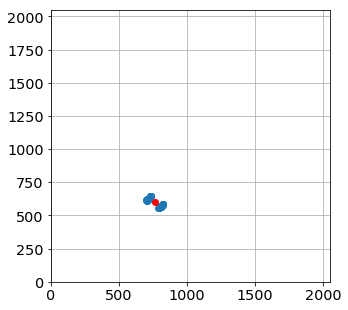

In [81]:
x_pointing = []
y_pointing = []
#for index,s in enumerate(img_sources):
for index in np.arange(len(all_images)):    
    #for ss in s:
    #    x_pointing.append(ss['xcentroid']+x_guess[index]-DeltaX_rot[index])
    #    y_pointing.append(ss['ycentroid']+y_guess[index]-DeltaY_rot[index])
    x_pointing.append(x_guess[index])
    y_pointing.append(y_guess[index])
    
        
x_mean = np.mean(x_pointing)
y_mean = np.mean(y_pointing)
img_size=all_images[0].shape
order0_positions = np.array([x_pointing,y_pointing]).T
print order0_positions

plt.figure(figsize=(5,5))
plt.plot(order0_positions.T[0],order0_positions.T[1],'o')
plt.plot(x_mean,y_mean,'ro')
plt.xlim(0,IMSIZE)
plt.ylim(0,IMSIZE)
plt.grid(True)

#####  cherche le nom de l'hologramme

In [82]:
print all_filt

['dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Thor300', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Thor300', 'dia HoloPhP', 'dia HoloPhAg', 'dia HoloAmAg', 'dia Thor300', 'dia Ho

In [83]:
all_grat = []
for f in all_filt :
    #all_grat.append(f.replace('RG715 ',''))
    all_grat.append(f.replace('dia ',''))
for index,g in enumerate(all_grat):
    holo = Hologram(g,verbose=False)
    print g,holo.theta(order0_positions[index]), all_theta[index]

Thor300 -0.575 -0.47222993739
HoloPhP [-0.95383322] -0.966580508048
HoloPhAg [-1.85158471] -1.89716032655
HoloAmAg [-1.9344096] -1.41772612896
Thor300 -0.575 -0.47998432295
HoloPhP [-0.95541669] -0.974238961744
HoloPhAg [-1.85754672] -1.90732502321
HoloAmAg [-1.94068318] -1.44398056637
Thor300 -0.575 -0.453661565407
HoloPhP [-0.95710859] -0.956867150278
HoloPhAg [-1.86417992] -1.88905589911
HoloAmAg [-1.94869654] -1.45443986739
Thor300 -0.575 -0.44472615403
HoloPhP [-0.9602804] -0.99567245485
HoloPhAg [-1.86966143] -1.91350077742
HoloAmAg [-1.95419072] -1.47341061551
Thor300 -0.575 -0.473608450208
HoloPhP [-0.96017717] -0.966980659061
HoloPhAg [-1.8760572] -1.91430433276
HoloAmAg [-1.96014372] -1.46723087792
Thor300 -0.575 -0.450804274729
HoloPhP [-0.9650608] -0.96471667072
HoloPhAg [-1.88043539] -1.93345768804
HoloAmAg [-1.96529175] -1.50089885114
Thor300 -0.575 -0.467014533692
HoloPhP [-0.96605776] -0.97833772015
HoloPhAg [-1.88681461] -1.91341904321
HoloAmAg [-1.97252656] -1.4600259

## Save results on rotated images

- Save the cut images after rotation
- Save also info on the position

In [84]:
newfullfilenames=[]
for idx,f in np.ndenumerate(sorted_files):
    short_infilename=f.split("/")[-1]
    short_partfilename=re.findall('^cutimg_(.*)',short_infilename)
    short_outfilename='rotimg_'+short_partfilename[0]
    newfullfilename=os.path.join(outputdir,short_outfilename)
    newfullfilenames.append(newfullfilename)

for idx,f in np.ndenumerate(newfullfilenames):
    prihdu = fits.PrimaryHDU(header=all_header[idx[0]],data=images_cut_rot[idx[0]])
    thdulist = fits.HDUList(prihdu)
    thdulist.writeto(f,overwrite=True)
textfilename=os.path.join(outputdir,'star_centroids.txt')
print textfilename
np.savetxt(textfilename,order0_positions,header="y_star x_star",fmt='%d')

!ls -l rotated_fitsimages

./rotated_fitsimages/star_centroids.txt
total 257928
-rw-r--r--  1 dagoret  LAL\Utilisateurs du domaine  1650240 Oct  6 12:38 rotimg_20170605_046.fits
-rw-r--r--  1 dagoret  LAL\Utilisateurs du domaine  1650240 Oct  6 12:38 rotimg_20170605_047.fits
-rw-r--r--  1 dagoret  LAL\Utilisateurs du domaine  1650240 Oct  6 12:38 rotimg_20170605_048.fits
-rw-r--r--  1 dagoret  LAL\Utilisateurs du domaine  1650240 Oct  6 12:38 rotimg_20170605_049.fits
-rw-r--r--  1 dagoret  LAL\Utilisateurs du domaine  1650240 Oct  6 12:38 rotimg_20170605_050.fits
-rw-r--r--  1 dagoret  LAL\Utilisateurs du domaine  1650240 Oct  6 12:38 rotimg_20170605_051.fits
-rw-r--r--  1 dagoret  LAL\Utilisateurs du domaine  1650240 Oct  6 12:38 rotimg_20170605_052.fits
-rw-r--r--  1 dagoret  LAL\Utilisateurs du domaine  1650240 Oct  6 12:38 rotimg_20170605_053.fits
-rw-r--r--  1 dagoret  LAL\Utilisateurs du domaine  1650240 Oct  6 12:38 rotimg_20170605_054.fits
-rw-r--r--  1 dagoret  LAL\Utilisateurs du domaine  1650240 Oct  

In [85]:
ar3 = {'x_pointing' :x_pointing, 'y_pointing' : y_pointing,'theta' :all_theta}
df3 = pd.DataFrame(ar3)

In [86]:
df3.to_csv('xy_pointing.csv')

In [87]:
df3

,theta,x_pointing,y_pointing
0,-0.472230,734.200949,647.719075
1,-0.966581,733.994455,645.712814
2,-1.897160,824.112296,585.786300
3,-1.417726,823.588894,585.639502
4,-0.479984,731.701102,645.702776
5,-0.974239,732.664538,643.811895
6,-1.907325,822.857492,583.602789
7,-1.443981,821.723290,583.660947
8,-0.453662,732.058860,643.557878
9,-0.956867,731.463414,641.926445


## End of Section 2 on rotation

- The following section will be removed.

- At this stage it is recommended to go to **Ana2DShapeSpectra** notebook

-------------------------------------------------------
# Section 3 : Extract spectra
---------------------------------------------------------

## Initialisation of Section 3

In [88]:
outputdir="./spectrum_fitsspec"
ensure_dir(outputdir)

inputdir="./rotated_fitsimages"
SelectTagRe='^rotimg_%s_([0-9]+).fits$' % date # regular expression to select the file
SearchTagRe='^rotimg_%s_[0-9]+.fits$' % date

### Get coordinate of order zero before rotation

In [89]:
df=pd.read_csv('xy_pointing.csv')

In [90]:
df.head()

,Unnamed: 0,theta,x_pointing,y_pointing
0,0,-0.472230,734.200949,647.719075
1,1,-0.966581,733.994455,645.712814
2,2,-1.897160,824.112296,585.786300
3,3,-1.417726,823.588894,585.639502
4,4,-0.479984,731.701102,645.702776


In [91]:
x_star=df["x_pointing"]
y_star=df["y_pointing"]

### Get coordinate of order zero after cut and rotation (in file)

In [92]:
df2=pd.read_csv('x_y_guess2.csv')

In [93]:
df2.head()

,Unnamed: 0,theta,x_guess2,y_guess2
0,0,-0.472230,735.253647,106.836525
1,1,-0.966581,735.587069,113.552699
2,2,-1.897160,826.780529,128.344163
3,3,-1.417726,825.593652,121.198030
4,4,-0.479984,732.701053,106.762561


In [94]:
x_star2=df2["x_guess2"]
y_star2=df2["y_guess2"]

In [95]:
sorted_numbers,sorted_files = MakeFileList([inputdir],MIN_IMGNUMBER,MAX_IMGNUMBER,SelectTagRe,SearchTagRe) 

all_dates,all_airmass,all_images,all_titles,all_header,all_expo,all_filt=BuildImages(sorted_files,sorted_numbers,object_name)

print 'Number of images:',len(all_images)

OSError: [Errno 24] Too many open files

In [ ]:
ShowImages(all_images,all_titles,all_filt,object_name,NBIMGPERROW=2,vmin=0,vmax=10000)

## Extraction of the spectrum from the 2D - Images


### Check the transverse spectrum does not show multi-bum

This proves the rotation may be OK

In [ ]:
they0=ShowTransverseProfile(all_images,all_titles,object_name,all_expo,NBIMGPERROW=2,
                      DeltaX=1000,w=5,ws=[20,30],right_edge=1800,ylim=(1e2,2e7))

## Extract the longitudinal spectrum with its lateral bands

In [ ]:
thespectra,thespectraUp,thespectraDown=ExtractSpectra(they0,all_images,all_titles,object_name,all_expo,
                                                      w=3,ws=[10,30],right_edge=1800)

In [ ]:
sel=0
plt.figure(figsize=(18,6))
plt.plot(thespectra[sel],'r-') 
plt.plot(thespectraUp[sel],'b-') 
plt.plot(thespectraDown[sel],'g-')
#plt.plot(Clean_Av[sel],'m-')
plt.grid(True)
plt.ylim(0,500.)
figfilename=os.path.join(dir_top_images,'bckg_sample.pdf')
plt.savefig(figfilename) 

In [ ]:
thespectraAv=np.array(thespectraUp+thespectraDown)/2.


In [ ]:
ShowLongitBackground(thespectra,thespectraUp,thespectraDown,thespectraAv,all_titles,all_filt,object_name,
                     NBIMGPERROW=2,right_edge=1800)

In [ ]:
import math as m
from matplotlib.backends.backend_pdf import PdfPages
def ShowFullLongitBackground(spectra,spectraUp,spectraDown,spectraAv,all_titles,object_name,NBIMGPERROW,dir_top_images):
    """
    Show the background to be removed to the spectrum
    
    Implemented to write in a pdf file
    
    """
    NBSPEC=len(spectra)
    MAXIMGROW=max(2,m.ceil(NBSPEC/NBIMGPERROW))
    
    # fig file specif
    NBIMGROWPERPAGE=5  # number of rows per pages
    PageNum=0          # page counter
    figfilename=os.path.join(dir_top_images,'background_longprofile.pdf')
    pp = PdfPages(figfilename) # create a pdf file
    
    title='Longitudinal background Up/Down'.format(object_name)
    
    
    spec_index_min=100  # cut the left border
    spec_index_max=1900 # cut the right border
    star_halfwidth=70
    
    for index in np.arange(0,NBSPEC):
        
        
        if index%(NBIMGPERROW*NBIMGROWPERPAGE) == 0:
            f, axarr = plt.subplots(NBIMGROWPERPAGE,NBIMGPERROW,figsize=(25,30))
            f.suptitle(title,size=20)
            
        # index of image in the page    
        indexcut=index-PageNum*(NBIMGROWPERPAGE*NBIMGPERROW)    
        ix=indexcut%NBIMGPERROW
        iy=indexcut/NBIMGPERROW
        
        # plot what is wanted
        axarr[iy,ix].plot(spectra[index],'r-')
        axarr[iy,ix].plot(spectraUp[index],'b-')
        axarr[iy,ix].plot(spectraDown[index],'g-')
        axarr[iy,ix].plot(spectraAv[index],'m-')
        axarr[iy,ix].set_title(all_titles[index])
        axarr[iy,ix].grid(True)
        
        star_pos=np.where(spectra[index][:spec_index_max]==spectra[index][:spec_index_max].max())[0][0]
        max_y_to_plot=(spectra[index][star_pos+star_halfwidth:spec_index_max]).max()*1.2
        
        
        axarr[iy,ix].set_ylim(0.,max_y_to_plot)
        axarr[iy,ix].text(spec_index_min,max_y_to_plot*1.1/1.2, all_filt[index],verticalalignment='top', horizontalalignment='center',color='blue',fontweight='bold', fontsize=20)
        
        
        # save a new page
        if (index+1)%(NBIMGPERROW*NBIMGROWPERPAGE) == 0:
            PageNum+=1  # increase page Number
            f.savefig(pp, format='pdf')
            f.show()
        
        
    
    
    f.savefig(pp, format='pdf') 
    f.show()
    pp.close()

In [ ]:
ShowFullLongitBackground(thespectra,thespectraUp,thespectraDown,thespectraAv,all_titles,object_name,2,dir_top_images)

## If OK apply background subtraction

In [ ]:
Clean_Up, Clean_Do,Clean_Av=CleanBadPixels(thespectraUp,thespectraDown) 

In [ ]:
ShowLongitBackground(thespectra,Clean_Up,Clean_Do,Clean_Av,all_titles,all_filt,object_name,
                     NBIMGPERROW=2,right_edge=1800)
figfilename=os.path.join(dir_top_images,'background_longprofile.pdf')
plt.savefig(figfilename)   

In [ ]:
sel=3
plt.figure(figsize=(18,8))
plt.plot(thespectra[sel],'r-') 
plt.plot(Clean_Up[sel],'b-') 
plt.plot(Clean_Do[sel],'g-')
plt.plot(Clean_Av[sel],'m-')
plt.grid(True)
plt.ylim(0,100.)

In [ ]:
thecorrspectra=CorrectSpectrumFromBackground(thespectra,Clean_Av)

ShowSpectrumProfile(thecorrspectra,all_titles,object_name,all_filt,NBIMGPERROW=2)
figfilename=os.path.join(dir_top_images,'correctedspectrum_profile.pdf')
plt.savefig(figfilename) 

In [ ]:
ShowSpectrumProfile(thecorrspectra,all_titles,object_name,all_filt,NBIMGPERROW=2,xlim=(750,1800))
figfilename=os.path.join(dir_top_images,'correctedspectrum_rightprofile.pdf')
plt.savefig(figfilename) 


## The real extraction will be done in another notebook

At this stage the work of extraction and rotation seems very good
